In [31]:
import numpy as np
import time

from collections import Counter

import plotly.graph_objects as go

In [72]:
class GTO: 
    def __init__(self, exponents):
        self.a = exponents*exponents # GTO orbital exponents
        self.maxl = 1 # maximum angular quantum number currently supported
        assert len(self.a) >= self.maxl+1, "%d exponents needed for maximum angular moment l=%d." % \
                                                        (self.maxl+1, self.maxl)
    
    def orbital(self, r, atom, l):
        """
        Evaluate Gaussian-type orbital (GTO) centered at R at position r.
        Supports s and p orbitals.
        """
        self._check_l(l)
        return self._gaussian_basis(r, atom.x, self.a[l], l)
    
    def overlap(self, atom1, atom2, l1, l2):
        """Computes the analytical overlap integral between two GTOs, including normalization.""" 
        self._check_l(l1)
        self._check_l(l2)
        
        return self._overlap_integral(atom1.x, atom2.x, self.a[l1], self.a[l2], l1, l2)
        
    def _check_l(self, l):
        assert l <= self.maxl, "GTOs not implemented for l=%d." % l
        
    def _gaussian_basis(self, r, R, alpha, l):
        '''evaluates GTO_i(r-R_i)'''
        
        prefactor = (2*alpha/np.pi)**(3/4) # normalisation prefactor 
        diff = r - R
        radial_part = np.array([np.exp(-alpha * d@d) for d in diff])
        
        if l == 0: 
            # s-orbital: 1x1 matrix
            return prefactor * radial_part
        elif l == 1:
            # p-orbital: 1x3 matrix
            return np.array([diff[i] * 2*alpha**(1/2) * prefactor * radial_part[i] for i in range(len(r))])
    
    
    def _overlap_integral(self, R_i, R_j, alpha_i, alpha_j, l_i, l_j):
        '''evaluates S_ij = int_R^3 GTO_i(r-R_i) GTO_j(r-R_j) dr^3'''
        
        p = alpha_i + alpha_j
        diff = R_j - R_i
        Rsq = diff@diff

        prefactor = 2*np.sqrt(2) * np.exp(-Rsq*alpha_i*alpha_j/p) * (alpha_i*alpha_j)**(3/4) / p**(3/2)

        if l_i == 0 and l_j == 0:  
            # s-s overlap: 1x1 matrix
            return np.array([prefactor])

        if l_i == 1 and l_j == 0:  
            # p-s overlap: 3x1 matrix
            return np.array([diff]).T * 2*prefactor * alpha_i**(1/2) * alpha_j/p

        if l_i == 0 and l_j == 1:  
            # s-p overlap: 1x3 matrix
            return np.array([-diff]) * 2*prefactor * alpha_j**(1/2) * alpha_i/p

        if l_i == 1 and l_j == 1:  
            # p-p overlap: 3x3 matrix 
            part = -np.outer(diff, diff) * 4*prefactor * (alpha_i * alpha_j)**(3/2)/p**2
            part += np.identity(3)       * 2*prefactor * (alpha_i * alpha_j)**(1/2)/p
            return part


In [73]:
class Atom:
    def __init__(self, species, position):
        self.x = np.array(position)
        self.species = species
        self.n = atomic_dictionary[species]["n"] # principal quantum number of valence shell
        self.l = atomic_dictionary[species]["l"] # highest angular momentum quantum number of valence shell 
        self.N = atomic_dictionary[species]["N"] # number of valence electrons
        self.H = atomic_dictionary[species]["V"] # onsite hamiltonian matrix elements in eV
        
class Molecule:
    def __init__(self, species, positions, verbose=True):
        
        # initialise list of atoms
        self.atoms = [Atom(_species,_xyz) for _species,_xyz in zip(species, positions)]
        
        # determine number of atoms, electrons, and orbitals in this molecule
        self.natoms = len(self.atoms)
        self.nelectrons = np.sum([atom.N for atom in self.atoms])
        
        self.norbitals = 0
        for atom in self.atoms:
            for l in range(atom.l+1):
                self.norbitals += 2*l+1
            
        if verbose:
            ct = Counter(species)
            atomstring = ["%s(%d)" % (key,ct[key]) for key in ct]
            print (f"Initialised a molecule containing %d atoms: " % self.natoms + "%s "*len(atomstring) % tuple(atomstring))
            print (f"The molecule has %d active orbitals and %d active electrons." % (self.norbitals, self.nelectrons))

    def move_atom(self, i, position):
        self.atoms[i].x = position
        
    def move_atoms(self, positions):
        for i,atom in enumerate(self.atoms):
            self.atoms[i].x = positions[i]
            
    def positions(self):
        return np.array([atom.x for atom in self.atoms])
        
    def species(self):
        return np.array([atom.species for atom in self.atoms])

In [47]:
class Electronic_Structure:
    def __init__(self, Molecule, Basis, coupling, verbose=True):
        self.Molecule = Molecule
        self.Basis = Basis
        
        # Wolfsberg–Helmholtz model for off-site elements Hij = k*Sij*(Hii+Hjj)/2
        self.k = coupling
        
        # initialise overlap and hamiltonian matrix 
        self.hamiltonian_matrix = np.zeros((self.Molecule.norbitals, self.Molecule.norbitals))
        self.overlap_matrix = np.zeros((self.Molecule.norbitals, self.Molecule.norbitals))
        
        self.verbose = verbose
        
    def update_matrices(self):        
        '''Construct Overlap and Hamiltonian matrices.'''
        clock = time.time()
        self._build_overlap()
        self._build_hamiltonian()
        clock = time.time() - clock
        if self.verbose:
            print (f"Constructed Overlap and Hamiltonian matrices in %8.4f ms." % (1e3*clock))
          
    def show_H(self):
        '''Print Hamiltonian matrix.'''
        for row in self.hamiltonian_matrix:
            print ("%7.3f "*len(row) % tuple(row))
        
    def show_S(self):
        '''Print Overlap matrix.'''
        for row in self.overlap_matrix:
            print ("%7.3f "*len(row) % tuple(row))            
            
    def solve_eigensystem(self):
        '''Solve H@c_i = ev_i*S@c_i eigensystem.'''
        clock = time.time()
        self.evals_og, self.evecs_og = np.linalg.eigh(np.linalg.inv(self.overlap_matrix)@self.hamiltonian_matrix)
        clock = time.time() - clock
        
        if self.verbose:
            print ("Solved eigensystem in %8.4f ms." % (1e3*clock))
        
        # sort by eigenvalues, ascending
        # but keep the original ones; we need them to reconstruct molecular orbitals
        order = np.argsort(self.evals_og)
        self.evals = self.evals_og[order]
        self.evecs = self.evecs_og[order]
        self.bands = self._occupy()
        self.homo_lumo = self._homo_lumo_gap()
        self.etotal = self._etotal()
        
        # report on the results
        if self.verbose:
            print ("\nElectronic structure properties:")
            print ("="*60)
            print (" band |    energy (eV)  | multiplicity | electron occupancy")
            for nb,row in enumerate(self.bands):
                print ("%4d  | %12.3f    |    %4d      |     %4d" % (nb, row[0], row[1], row[2]))

            print ("\nHOMO-LUMO gap (eV): %12.3f" % self.homo_lumo)
            print ("\nTotal energy  (eV): %12.3f" % self.etotal)

        
    def _occupy(self, precision=0.01):
        '''Fill up the bands, starting from the bottom, accounting for multiplicity.'''
        
        assert hasattr(self, "evals"), "No eigenvalues available! Run solve_eigensystem() first."
        
        # round eigenvalues to given precision to help detection of degenerate states
        evals_rounded = np.array(self.evals/precision, int)*precision
        evals_uq, evals_ct = np.unique(evals_rounded, return_counts=True)

        # distribute the electrons across the bands
        nremaining = self.Molecule.nelectrons
        occupancies = np.zeros(evals_uq.size)
        for ei,ev in enumerate(evals_uq):
            nev = evals_ct[ei]
            npool = 2*nev
            occupancies[ei] = min(npool, nremaining)
            nremaining -= occupancies[ei]
        
        # matrix with columns: band energy (eV), band degeneracy, band occupancy 
        return np.c_[evals_uq, evals_ct, occupancies]
  
    def _homo_lumo_gap(self):
        '''Return the energy difference between lowest unocc and highest occ band in eV.'''
        
        assert hasattr(self, "evals"), "No bands available! Run _occupy() first."
        homo = self.bands[np.argwhere(self.bands[:,2]>1)[-1,0],0]
        lumo = self.bands[np.argwhere(self.bands[:,2]==0)[0,0],0]
        return lumo - homo
    
    def _etotal(self):
        '''Return the total electronic energy in eV.'''
        assert hasattr(self, "bands"), "No bands available! Run _occupy() first."
        return np.sum(self.bands[:,0]*self.bands[:,1]*self.bands[:,2])
    
    def _homo_lumo_gap(self):
        '''Return the energy difference between lowest unocc and highest occ band in eV.'''
        assert hasattr(self, "bands"), "No bands available! Run _occupy() first."
        homo = self.bands[np.argwhere(self.bands[:,2]>1)[-1,0],0]
        lumo = self.bands[np.argwhere(self.bands[:,2]==0)[0,0],0]
        return lumo - homo
        
        
    def _build_overlap(self):
        atoms = self.Molecule.atoms
        natoms = len(atoms)
                
        # looping over atoms i,j, populate overlap matrix by evaluating overlap integrals
        oi = 0
        for i in range(natoms):
            atom1 = atoms[i]
            for l1 in range(atom1.n):

                oj = 0
                for j in range(natoms):
                    atom2 = atoms[j]
                    for l2 in range(atom2.n):
                        S_il1_jl2 = self.Basis.overlap(atom1, atom2, l1, l2)
                        self.overlap_matrix[oi:oi+2*l1+1, oj:oj+2*l2+1] = S_il1_jl2
                        oj += 2*l2+1

                oi += 2*l1+1 

    def _build_hamiltonian(self):
        atoms = self.Molecule.atoms
        natoms = len(atoms)
        
        # check if this is an onsite matrix element
        onsite = lambda atom1, atom2: np.linalg.norm(atom1.x - atom2.x) < 1e-9

        # looping over atoms i,j, populate hamiltonian matrix by evaluating hopping integrals
        oi = 0
        for i in range(natoms):
            atom1 = atoms[i]
            for l1 in range(atom1.n):

                oj = 0
                for j in range(natoms):
                    atom2 = atoms[j]
                    for l2 in range(atom2.n):

                        if onsite(atom1, atom2):
                            if l1==l2:
                                H_il1_jl2 = np.diag([atom1.H[l1]]*(2*l1+1)) 
                            else:
                                H_il1_jl2 = np.zeros((2*l1+1, 2*l2+1))

                        else:
                            # Wolfsberg–Helmholtz relation
                            S_il1_jl2 = self.Basis.overlap(atom1, atom2, l1, l2)
                            H_il1_jl2 = self.k * S_il1_jl2 * (atom1.H[l1]+atom2.H[l2])/2.

                        self.hamiltonian_matrix[oi:oi+2*l1+1, oj:oj+2*l2+1] = H_il1_jl2
                        oj += 2*l2+1

                oi += 2*l1+1


In [191]:
class Evaluate_Molecular_Orbital:
    def __init__(self, Electronic_Structure, plotspan=5.0, nres=40j):
        self.electronic_structure = Electronic_Structure
        
        self.molecule = self.electronic_structure.Molecule
        self.basis = self.electronic_structure.Basis

        self.positions = self.molecule.positions()
        self.species = self.molecule.species()
        
        # fetch centre of molecule 
        x0,y0,z0 = np.mean(self.molecule.positions(), axis=0)
        
        # plotspan
        ps = plotspan

        # number of plot points along each dimension
        nr = nres

        # intialise voxel grid and grid xyz coordinates
        self.xs = np.array(np.mgrid[x0-ps:x0+ps:nr, y0-ps:y0+ps:nr, z0-ps:z0+ps:nr])
        self.rpos = np.transpose(self.xs.reshape(3,-1))
        
        # initialise voxel grid for the wavefunction
        self.wfunc = np.zeros(self.rpos.shape[0])

    def __call__(self, orbital_id, rescale=True):
        
        assert orbital_id < self.molecule.norbitals, "There are only %d molecular orbitals!" % self.molecule.norbitals

        self.wfunc *= 0.0
        
        # loop over every atom and orbital, and add amplitude to the wavefunction voxel grid
        counter = 0 # gtobasis.orbital() returns all orbitals for a given l, i.e. in spans of 2*l+1
        for atom in self.molecule.atoms:
            for l in range(atom.l+1):
                 
                atvals = self.basis.orbital(self.rpos, atom, l)
                weight = self.electronic_structure.evecs_og.T[orbital_id][counter:counter+2*l+1]
        
                if l == 0:
                    self.wfunc += weight*atvals
                if l >= 1:
                    self.wfunc += np.einsum("i,ji->j", weight, atvals)
                    
                counter += 2*l+1
        
        if rescale:
            # rescale for visualisation
            self.wfunc = np.sign(self.wfunc) * np.sqrt(np.abs(self.wfunc)) 
    


In [115]:
# global model parameters
model_parameters = {
    "Bohr_radii": [0.52917721, 2*0.52917721],  # bohr radii for n=1,2 in Angstrom, for orbital range
    "Wolfsberg–Helmholtz" : 1.75 # Hij = k*Sij*(Hii+Hjj)/2 approximation for inter-atomic matrix elements
}

# global atomic properties
atomic_dictionary = {
        "H": {"N": 1, "n": 1, "l": 0, "V": [-13.6]},
        "C": {"N": 4, "n": 2, "l": 1, "V": [-19.44, -10.67]},
} 

In [211]:
species = ["C", "H", "H", "H", "H"]

positions = np.array([
    [0,0,0],
    [0,0,1.089],
    [-0.51336,-0.889165,-0.363000],
    [-0.513360, 0.889165,-0.363000],
    [1.026719, 0, -0.363000]
])

# initialise molecule
methane = Molecule(species, positions)

# initialise GTO basis set
gtobasis = GTO(.8/np.array(model_parameters["Bohr_radii"])) # confine more

Initialised a molecule containing 5 atoms: C(1) H(4) 
The molecule has 8 active orbitals and 8 active electrons.


In [212]:
methane_sol = Electronic_Structure(methane, gtobasis, model_parameters["Wolfsberg–Helmholtz"])
methane_sol.update_matrices()
methane_sol.solve_eigensystem()

Constructed Overlap and Hamiltonian matrices in   4.4270 ms.
Solved eigensystem in   0.9179 ms.

Electronic structure properties:
 band |    energy (eV)  | multiplicity | electron occupancy
   0  |      -19.850    |       1      |        2
   1  |      -17.420    |       3      |        6
   2  |       -6.100    |       1      |        0
   3  |        6.360    |       3      |        0

HOMO-LUMO gap (eV):       11.320

Total energy  (eV):     -353.260


In [225]:
emo = Evaluate_Molecular_Orbital(methane_sol, plotspan=3)

emo(4)

# grid coordinates
X, Y, Z = emo.xs

fig = go.Figure([
        go.Scatter3d(
            x=emo.positions[:,0], y=emo.positions[:,1], z=emo.positions[:,2],
            mode='markers',
            marker=dict(
                size=6,
                color="black"
            )
        ), 
        go.Isosurface(
            x=X.flatten(),
            y=Y.flatten(),
            z=Z.flatten(),
            value=emo.wfunc,
            colorscale='BlueRed',
            cmax=.1,
            cmin=-.1,
            cmid=0.0,
            opacity=0.2,
            isomin=-1.0,
            isomax=1.0,
            surface_count=10,
            caps=dict(x_show=False, y_show=False, z_show=False),
            showscale=False, 
        )

])

fig.show()

In [226]:
def make_polyethylene(ncarbon=5):
    nhydrogen = 2*ncarbon + 2
    positions = np.zeros((ncarbon+nhydrogen,3))

    cc_bond = 1.54 # Ang
    ch_bond = 1.09 # Ang
    angle_deg = 109.5
    angle_rad = (90-109.5/2)/180 * np.pi
    dx = cc_bond * np.cos(angle_rad)
    dy = cc_bond * np.sin(angle_rad)

    # place the carbon atoms
    sign = 1
    for ni in range(1, ncarbon):
        positions[ni] = positions[ni-1]
        positions[ni][0] += dx
        positions[ni][1] += sign * dy
        sign *= -1
        
    # place the hydrogen atoms
    sign = -1
    for ni in range(0, ncarbon):
        positions[ncarbon+2*ni+0] = positions[ni] 
        positions[ncarbon+2*ni+1] = positions[ni]
        positions[ncarbon+2*ni+0][1] += sign * 1/np.sqrt(2) * ch_bond
        positions[ncarbon+2*ni+1][1] += sign * 1/np.sqrt(2) * ch_bond

        positions[ncarbon+2*ni+0][2] += 1/np.sqrt(2) * ch_bond
        positions[ncarbon+2*ni+1][2] -= 1/np.sqrt(2) * ch_bond

        sign *= -1

    # place the end hydrogen atoms
    positions[ncarbon+nhydrogen-2] = positions[0]
    positions[ncarbon+nhydrogen-1] = positions[ncarbon-1]

    positions[ncarbon+nhydrogen-2][0] -= ch_bond 
    positions[ncarbon+nhydrogen-1][0] += ch_bond
    
    return ["C"]*ncarbon + ["H"]*nhydrogen, positions

In [327]:
_spec,_pos = make_polyethylene(ncarbon=10)
# initialise molecule
polyethylene = Molecule(_spec, _pos)

# initialise GTO basis set
gtobasis = GTO(.5/np.array(model_parameters["Bohr_radii"]))

pe_sol = Electronic_Structure(polyethylene, gtobasis, model_parameters["Wolfsberg–Helmholtz"])
pe_sol.update_matrices()
pe_sol.solve_eigensystem()


Initialised a molecule containing 32 atoms: C(10) H(22) 
The molecule has 62 active orbitals and 62 active electrons.
Constructed Overlap and Hamiltonian matrices in  54.1689 ms.
Solved eigensystem in   2.1408 ms.

Electronic structure properties:
 band |    energy (eV)  | multiplicity | electron occupancy
   0  |      -36.140    |       1      |        2
   1  |      -35.370    |       1      |        2
   2  |      -31.820    |       1      |        2
   3  |      -28.700    |       1      |        2
   4  |      -26.630    |       1      |        2
   5  |      -24.970    |       1      |        2
   6  |      -23.640    |       1      |        2
   7  |      -22.570    |       1      |        2
   8  |      -21.400    |       1      |        2
   9  |      -21.040    |       1      |        2
  10  |      -21.010    |       1      |        2
  11  |      -18.560    |       1      |        2
  12  |      -17.680    |       1      |        2
  13  |      -16.890    |       1      |  

In [330]:
emo = Evaluate_Molecular_Orbital(pe_sol, plotspan=14)

emo(31)

# grid coordinates
X, Y, Z = emo.xs

fig = go.Figure([
        go.Scatter3d(
            x=emo.positions[:,0], y=emo.positions[:,1], z=emo.positions[:,2],
            mode='markers',
            marker=dict(
                size=6,
                color="black"
            )
        ), 
        go.Isosurface(
            x=X.flatten(),
            y=Y.flatten(),
            z=Z.flatten(),
            value=emo.wfunc,
            colorscale='BlueRed',
            cmax=.1,
            cmin=-.1,
            cmid=0.0,
            opacity=0.2,
            isomin=-0.2,
            isomax=0.2,
            surface_count=10,
            caps=dict(x_show=False, y_show=False, z_show=False),
            showscale=False, 
        )

])

fig.show()

In [339]:
res = []
for nc in [4, 6, 8, 10, 16, 20, 25, 30, 40, 50]:
    _spec,_pos = make_polyethylene(ncarbon=nc)
    # initialise molecule
    polyethylene = Molecule(_spec, _pos, verbose=False)
    
    # initialise GTO basis set
    gtobasis = GTO(0.7/np.array(model_parameters["Bohr_radii"]))
    
    pe_sol = Electronic_Structure(polyethylene, gtobasis, model_parameters["Wolfsberg–Helmholtz"], verbose=False)
    pe_sol.update_matrices()
    pe_sol.solve_eigensystem()
    
    res += [[nc, pe_sol.homo_lumo]]

res = np.array(res)

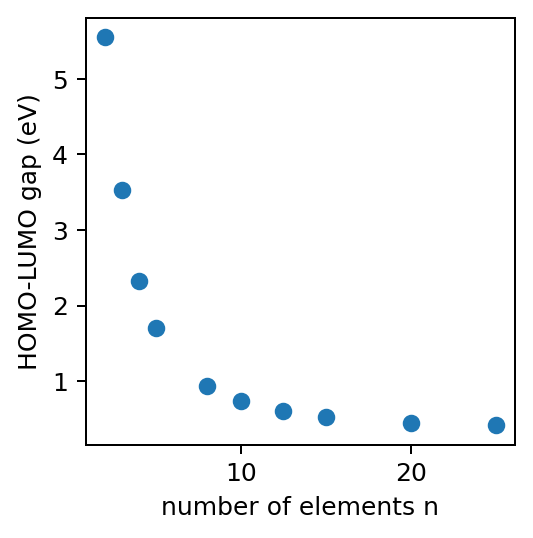

In [340]:
# Plot Fig
from matplotlib import pyplot as plt

fig = plt.figure(figsize=(3.08, 3.08), dpi=180) 
ax = fig.add_subplot(1,1,1)

ax.set_xlabel("number of elements n")
ax.set_ylabel("HOMO-LUMO gap (eV)")

plt.scatter(res[:,0]/2, res[:,1])
